In [1]:
%load_ext autoreload
%autoreload 2


In [2]:
import os
import numpy as np
import scanpy as sc
import time
from pathlib import Path
import torch
import concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib as mpl
from scipy import sparse
from scib_metrics.benchmark import Benchmarker, BioConservation, BatchCorrection
import pickle

In [3]:
proj_name = "pancreatic_islet_Hrovatin"
file_name = "pancreatic_islet_Hrovatin"
file_suffix = time.strftime('%b%d-%H%M')
seed = 0

save_dir = Path(f"../save/{proj_name}-{file_suffix}")
save_dir.mkdir(parents=True, exist_ok=True)

data_dir = Path(f"../data/{proj_name}")
data_dir.mkdir(parents=True, exist_ok=True)

ccd.ul.set_seed(seed)

In [4]:
adata =  sc.read_h5ad(data_dir / f"{file_name}_final.h5ad")

In [5]:
adata

AnnData object with n_obs × n_vars = 301723 × 31202
    obs: 'batch_integration', 'dataset', 'design', 'cell_cycle_phase', 'ins_high', 'gcg_high', 'sst_high', 'ppy_high', 'cell_filtering', 'strain', 'age', 'cell_type_originalDataset_unified', 'cell_type_originalDataset', 'cell_type_reannotatedIntegrated', 'n_genes', 'mt_frac', 'doublet_score', 'log10_n_counts', 'age_approxDays', 'dataset__design__sample', 'cell_subtype_immune_reannotatedIntegrated', 'cell_subtype_endothelial_reannotatedIntegrated', 'emptyDrops_LogProb_scaled', 'cell_subtype_beta_coarse_reannotatedIntegrated', 'cell_subtype_beta_fine_reannotatedIntegrated', 'GP_1', 'GP_2', 'GP_3', 'GP_4', 'GP_5', 'GP_6', 'GP_7', 'GP_8', 'GP_9', 'GP_10', 'GP_11', 'GP_12', 'GP_13', 'GP_14', 'GP_15', 'GP_16', 'GP_17', 'GP_18', 'GP_19', 'GP_20', 'GP_21', 'GP_22', 'GP_23', 'GP_24', 'GP_25', 'GP_26', 'GP_27', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'diabetes_model', 'chemical_stress', 'GEO

# upload obsm from h5 file

In [6]:
import h5py

h5_path = "../save/obsm_concord-1.0.3_Jul03/obsm_pancreatic_islet_Hrovatin_Jul06-0632.h5"

def print_h5_structure(g, prefix=""):
    for key in g.keys():
        item = g[key]
        if isinstance(item, h5py.Group):
            print(f"{prefix}{key}/ (Group)")
            print_h5_structure(item, prefix=prefix + key + "/")
        elif isinstance(item, h5py.Dataset):
            print(f"{prefix}{key:50s} shape: {item.shape}")

with h5py.File(h5_path, 'r') as f:
    print_h5_structure(f)

obsm/ (Group)
obsm/X_integrated_umap                                  shape: (301723, 2)
obsm/X_integrated_umap_beta                             shape: (301723, 2)
obsm/concord_hcl                                        shape: (301723, 50)
obsm/concord_hcl_UMAP                                   shape: (301723, 2)
obsm/concord_hcl_UMAP_3D                                shape: (301723, 3)
obsm/concord_knn                                        shape: (301723, 50)
obsm/concord_knn_UMAP                                   shape: (301723, 2)
obsm/concord_knn_UMAP_3D                                shape: (301723, 3)
obsm/contrastive                                        shape: (301723, 50)
obsm/contrastive_UMAP                                   shape: (301723, 2)
obsm/contrastive_UMAP_3D                                shape: (301723, 3)
obsm/harmony                                            shape: (301723, 50)
obsm/harmony_UMAP                                       shape: (301723, 2)
obsm/ha

In [7]:
obsm_keys_to_copy = [
    "contrastive_UMAP", "contrastive_UMAP_3D",
    "harmony_UMAP", "harmony_UMAP_3D",
    "scanorama_UMAP", "scanorama_UMAP_3D",
    "scvi_UMAP", "scvi_UMAP_3D",
    "unintegrated_UMAP", "unintegrated_UMAP_3D",
    "liger_UMAP", "liger_UMAP_3D",
]

In [8]:
with h5py.File(h5_path, 'r') as f:
    obsm_group = f['obsm']
    for key in obsm_keys_to_copy:
        if key in obsm_group:
            data = obsm_group[key][:]
            assert data.shape[0] == adata.n_obs, f"Shape mismatch for {key}"
            print(f"✅ Appending: {key}")
            adata.obsm[key] = data
        else:
            print(f"⚠️  Skipped (not found): {key}")

✅ Appending: contrastive_UMAP
✅ Appending: contrastive_UMAP_3D
✅ Appending: harmony_UMAP
✅ Appending: harmony_UMAP_3D
✅ Appending: scanorama_UMAP
✅ Appending: scanorama_UMAP_3D
✅ Appending: scvi_UMAP
✅ Appending: scvi_UMAP_3D
✅ Appending: unintegrated_UMAP
✅ Appending: unintegrated_UMAP_3D
✅ Appending: liger_UMAP
✅ Appending: liger_UMAP_3D


In [9]:
adata.write(data_dir / f"{file_name}_final.h5ad")

In [10]:
adata

AnnData object with n_obs × n_vars = 301723 × 31202
    obs: 'batch_integration', 'dataset', 'design', 'cell_cycle_phase', 'ins_high', 'gcg_high', 'sst_high', 'ppy_high', 'cell_filtering', 'strain', 'age', 'cell_type_originalDataset_unified', 'cell_type_originalDataset', 'cell_type_reannotatedIntegrated', 'n_genes', 'mt_frac', 'doublet_score', 'log10_n_counts', 'age_approxDays', 'dataset__design__sample', 'cell_subtype_immune_reannotatedIntegrated', 'cell_subtype_endothelial_reannotatedIntegrated', 'emptyDrops_LogProb_scaled', 'cell_subtype_beta_coarse_reannotatedIntegrated', 'cell_subtype_beta_fine_reannotatedIntegrated', 'GP_1', 'GP_2', 'GP_3', 'GP_4', 'GP_5', 'GP_6', 'GP_7', 'GP_8', 'GP_9', 'GP_10', 'GP_11', 'GP_12', 'GP_13', 'GP_14', 'GP_15', 'GP_16', 'GP_17', 'GP_18', 'GP_19', 'GP_20', 'GP_21', 'GP_22', 'GP_23', 'GP_24', 'GP_25', 'GP_26', 'GP_27', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'diabetes_model', 'chemical_stress', 'GEO

----

# time and memory profiling

In [11]:
methods = ["unintegrated", "liger", "harmony", "scanorama", "scvi", "contrastive", "concord_knn", "concord_hcl"]

✅ Benchmark summary saved to: ../save/pancreatic_islet_Hrovatin-Jul17-1702/benchmark_summary_Jul17-1702.tsv


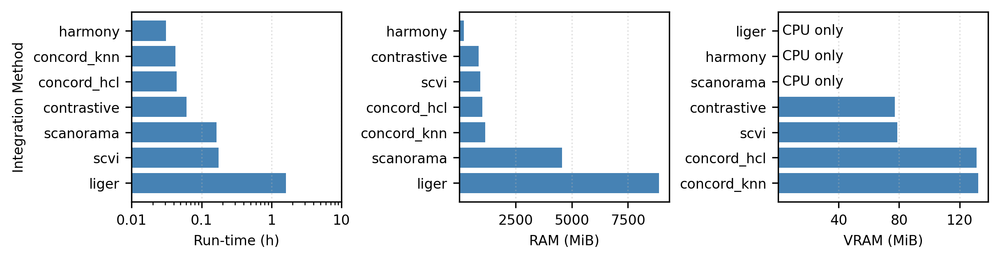

In [13]:
from benchmark_utils import collect_benchmark_logs
bench_df = collect_benchmark_logs(proj_name, methods)
# Save the benchmark results
bench_df.to_csv(save_dir / f"benchmark_summary_{file_suffix}.tsv", sep="\t", index=False)
print(f"✅ Benchmark summary saved to: {save_dir / f'benchmark_summary_{file_suffix}.tsv'}")
# Plot benchmark results
from benchmark_utils import plot_benchmark_performance
import matplotlib.pyplot as plt
custom_rc = {
    'font.family': 'DejaVu Sans',  # Set the desired font for this plot
}
with plt.rc_context(rc=custom_rc):
    plot_benchmark_performance(bench_df, figsize=(8,2), dpi=300, 
                               save_path = save_dir / f"benchmark_plot_{file_suffix}.pdf",
                               label_fontsize=8)


----

# UMAP

In [14]:
methods = ["unintegrated", "liger", "harmony", "scanorama", "scvi", "contrastive", "concord_knn", "concord_hcl"]

batch_key = 'batch_integration'
state_key = 'cell_type'

concord.plotting.pl_embedding - INFO - Plotting unintegrated with batch_integration in UMAP
concord.plotting.pl_embedding - INFO - Plotting liger with batch_integration in UMAP
concord.plotting.pl_embedding - INFO - Plotting harmony with batch_integration in UMAP
concord.plotting.pl_embedding - INFO - Plotting scanorama with batch_integration in UMAP
concord.plotting.pl_embedding - INFO - Plotting scvi with batch_integration in UMAP
concord.plotting.pl_embedding - INFO - Plotting contrastive with batch_integration in UMAP
concord.plotting.pl_embedding - INFO - Plotting concord_knn with batch_integration in UMAP
concord.plotting.pl_embedding - INFO - Plotting concord_hcl with batch_integration in UMAP


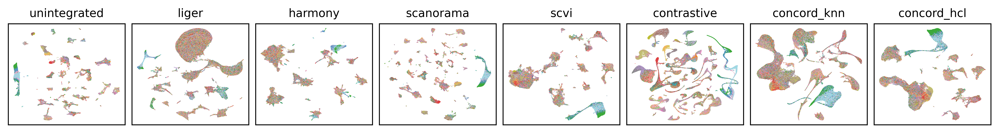

concord.plotting.pl_embedding - INFO - Plotting unintegrated with cell_type in UMAP
concord.plotting.pl_embedding - INFO - Plotting liger with cell_type in UMAP
concord.plotting.pl_embedding - INFO - Plotting harmony with cell_type in UMAP
concord.plotting.pl_embedding - INFO - Plotting scanorama with cell_type in UMAP
concord.plotting.pl_embedding - INFO - Plotting scvi with cell_type in UMAP
concord.plotting.pl_embedding - INFO - Plotting contrastive with cell_type in UMAP
concord.plotting.pl_embedding - INFO - Plotting concord_knn with cell_type in UMAP
concord.plotting.pl_embedding - INFO - Plotting concord_hcl with cell_type in UMAP


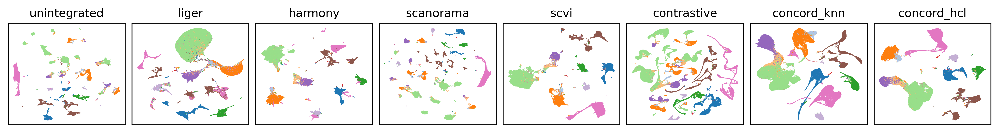

In [16]:
# plot everything
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import rcParams
import seaborn as sns

# Set DejaVu Sans as the default font
custom_rc = {
    'font.family': 'DejaVu Sans',  # Set the desired font for this plot
}

show_keys = methods
show_cols = [batch_key, state_key]
basis_types = ['UMAP']

font_size=10
point_size=1
alpha=0.8
ncols = len(show_keys)
figsize=(ncols * 1.5,1.5)
nrows = int(np.ceil(len(show_keys) / ncols))
pal = {}
for key in [batch_key, state_key]:
    n_categories = adata.obs[key].nunique()
    _, _, pal[key] = ccd.pl.get_color_mapping(adata,key, pal='tab20', seed=seed)

with plt.rc_context(rc=custom_rc):
    ccd.pl.plot_all_embeddings(
        adata,
        show_keys,
        color_bys=show_cols,
        basis_types=basis_types,
        pal=pal,
        font_size=font_size,
        point_size=point_size,
        alpha=alpha,
        figsize=figsize,
        ncols=ncols,
        seed=seed,
        save_dir=save_dir,
        file_suffix=file_suffix,
        dpi=600,
        save_format='svg'
    )


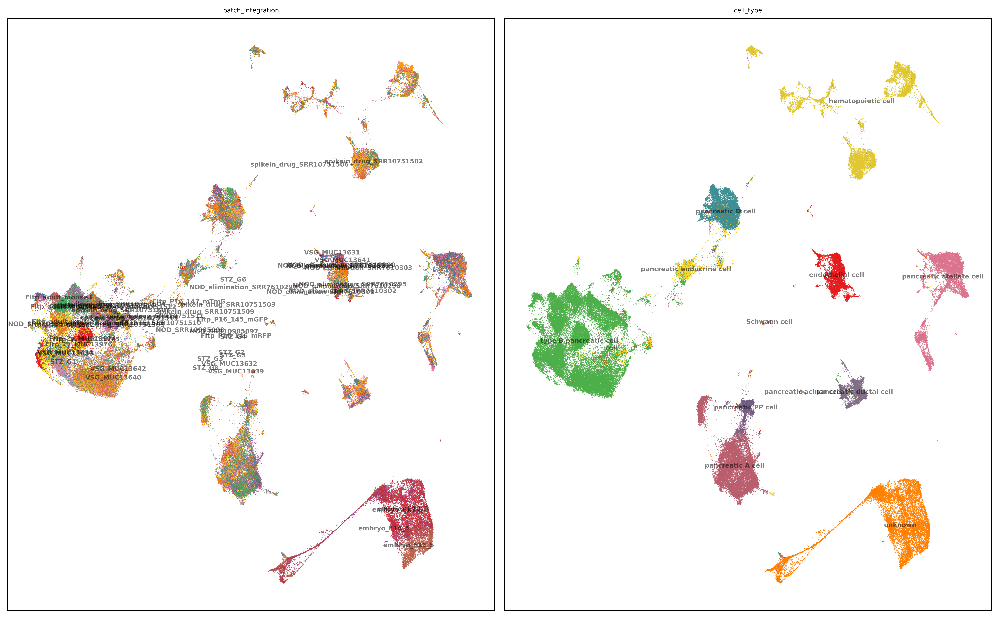

In [17]:
show_basis = 'scvi_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, pal='Set1', figsize=(13,8), dpi=600, ncols=2, font_size=6, point_size=1, legend_loc='on data',
    save_path=None
)

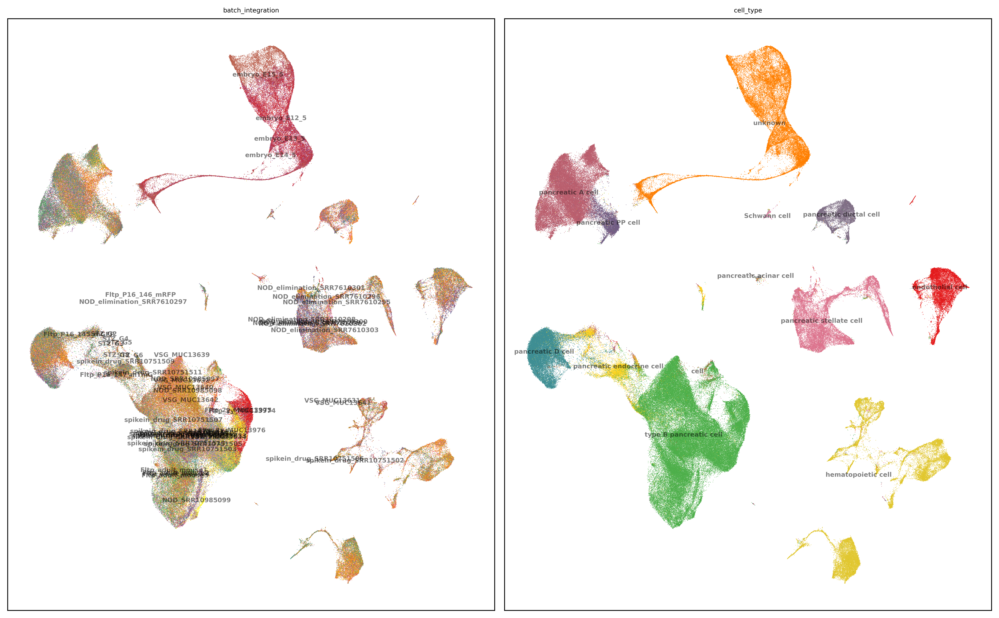

In [18]:
show_basis = 'concord_hcl_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, pal='Set1', figsize=(13,8), dpi=600, ncols=2, font_size=6, point_size=1, legend_loc='on data',
    save_path=None
)